# Imports #

In [1]:
import pandas as pd
import numpy as np
import datetime
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import  OneHotEncoder, StandardScaler
from sklearn.compose import ColumnTransformer
from sklearn.metrics import accuracy_score, r2_score, mean_squared_error, mean_absolute_error

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning) # to avoid deprecation warnings

from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression , Lasso , Ridge, RidgeCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, BaggingRegressor, AdaBoostRegressor, VotingRegressor, StackingRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor 
from sklearn.svm import SVR, LinearSVR
from catboost import CatBoostRegressor

import matplotlib.pyplot as plt

import joblib

# Preprocessing #

In [2]:
pricing = pd.read_csv('/Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/EDA/get_around_pricing_project.csv',index_col=0)

In [3]:
# Removal of outliers
upper_fence = 287
mask = (pricing['rental_price_per_day'] < upper_fence)
pricing = pricing.loc[mask,:]

In [4]:
# Feature engineering:

# pricing['mileage_2'] = pricing['mileage']**2
# pricing['mileage_ln'] = np.log(pricing['mileage'])
# pricing['engine_power_2'] = pricing['engine_power']**2
# pricing['engine_power_3'] = pricing['engine_power']**3
# pricing['mileage_engine_power'] = pricing['mileage']*pricing['engine_power']
# pricing['mileage_2_engine_power'] = pricing['mileage']**2 * pricing['engine_power']

# Remove missing values created by the logarithm:
# pricing.dropna(subset=['mileage_ln'], inplace=True)

print('All feature engineering were tested on XGBoost, the best model, and all of the decreased the R² for test.')

All feature engineering were tested on XGBoost, the best model, and all of the decreased the R² for test.


In [5]:
# Separate target variable Y from features X

print()
target_variable = "rental_price_per_day"
print("Target variable: ",target_variable)
Y = pricing.loc[:,target_variable]
print('Y : ')
print(Y.head())

features_list = pricing.drop(target_variable,axis=1).columns.tolist()
print("Features list: ",features_list)
X = pricing.loc[:,features_list]
print('X :')
print(X.head())
categorical_indices = [0,3,4,5,6,7,8,9,10,11,12]
numeric_indices = [1,2]


Target variable:  rental_price_per_day
Y : 
0    106
1    264
2    101
3    158
4    183
Name: rental_price_per_day, dtype: int64
Features list:  ['model_key', 'mileage', 'engine_power', 'fuel', 'paint_color', 'car_type', 'private_parking_available', 'has_gps', 'has_air_conditioning', 'automatic_car', 'has_getaround_connect', 'has_speed_regulator', 'winter_tires']
X :
  model_key  mileage  engine_power    fuel paint_color     car_type  \
0   Citroën   140411           100  diesel       black  convertible   
1   Citroën    13929           317  petrol        grey  convertible   
2   Citroën   183297           120  diesel       white  convertible   
3   Citroën   128035           135  diesel         red  convertible   
4   Citroën    97097           160  diesel      silver  convertible   

   private_parking_available  has_gps  has_air_conditioning  automatic_car  \
0                       True     True                 False          False   
1                       True     True        

In [6]:
# Divide dataset Train set & Test set 
print("Dividing into train and test sets...")
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, random_state=0)
print("...Done.")
print()

# # Divide dataset into train, validation, and test sets
# print("Dividing into train, validation, and test sets...")
# X_train, X_test_val, Y_train, Y_test_val = train_test_split(X, Y, test_size=0.3, random_state=0)
# X_val, X_test, Y_val, Y_test = train_test_split(X_test_val, Y_test_val, test_size=0.5, random_state=0)
# print("...Done.")
# print()

Dividing into train and test sets...
...Done.



In [7]:
# Create pipeline for numeric features
numeric_transformer = Pipeline(steps=[
    # ('imputer', SimpleImputer(strategy='mean')), # missing values will be replaced by columns' median
    ('scaler', StandardScaler())
])

# Create pipeline for categorical features
categorical_transformer = Pipeline(
    steps=[
    # ('imputer', SimpleImputer(strategy='most_frequent')), # missing values will be replaced by most frequent value
    ('encoder', OneHotEncoder(drop='first',categories='auto',handle_unknown='ignore')) # first column will be dropped to avoid creating correlations between features, auto for representations of all catego
    ])

# Applying pipeline on X variables depending on columns
feature_encoder = ColumnTransformer(
    transformers=[
        ('cat', categorical_transformer, categorical_indices),    
        ('num', numeric_transformer, numeric_indices)
        ]
    )

# Preprocessings on train set
print("Performing preprocessings on train set...")
print(X_train.head())
X_train = feature_encoder.fit_transform(X_train)
print('...Done.')
print(X_train[0:5,:])
print()

# Preprocessings on test set
print("Performing preprocessings on test set...")
print(X_test.head())
X_test = feature_encoder.transform(X_test) # Don't fit again !!
print('...Done.')
print(X_test[0:5,:])
print()

Performing preprocessings on train set...
     model_key  mileage  engine_power    fuel paint_color   car_type  \
2039      Audi   187514           135  diesel        grey  hatchback   
901    Renault   161618           120  diesel       black     estate   
934    Peugeot   179647           100  diesel       black     estate   
2261  Mercedes    60013           100  diesel       white  hatchback   
3376  Mercedes   173888           100  diesel        blue      sedan   

      private_parking_available  has_gps  has_air_conditioning  automatic_car  \
2039                       True     True                 False          False   
901                        True     True                 False          False   
934                        True     True                 False          False   
2261                       True     True                 False          False   
3376                       True     True                 False          False   

      has_getaround_connect  has_speed

In [8]:
Y_train = Y_train.to_numpy().reshape(-1,1)
Y_test = Y_test.to_numpy().reshape(-1,1)

scaler = StandardScaler()

print("Preprocessing Y_train and Y_test")
Y_train = scaler.fit_transform(Y_train)
print(Y_train[0:5,:])
Y_test = scaler.transform(Y_test)
print(Y_test[0:5,:])

# Convert Y_train and Y_test to 1-dimensional arrays (due to a problem with decision tree) (ravel = to_numpy)
Y_train = Y_train.ravel()
Y_test = Y_test.ravel()

Preprocessing Y_train and Y_test
[[ 0.05997545]
 [-0.18322473]
 [-0.24402478]
 [-0.03122462]
 [-0.42642492]]
[[-0.76082518]
 [-0.06162464]
 [ 0.45517576]
 [-0.33522485]
 [-0.18322473]]


# MODELS #

In [9]:
# Models to be tested

models = [
    {
        'name': 'Linear Regression',
        'model': LinearRegression(),
        'params': {}
    },
    {
        'name': 'Lasso',
        'model': Lasso(),
        'params': {'alpha': [0.1, 0.5, 1.0, 2, 3, 5, 10]} 
    },
    {
        'name': 'Ridge',
        'model': Ridge(),
        'params': {'alpha': [0.1, 0.5, 1.0, 2, 3, 5, 10]}  
    },
    {
        'name': 'Decision Tree',
        'model': DecisionTreeRegressor(),
        'params': {
            'max_depth': [1, 2, 3, 4, 6, 8, 10, 12, 15, 20], 
            'min_samples_leaf': [1, 2, 5],
            'min_samples_split': [2, 4, 8]
        }
    },
    {
        'name': 'Random Forest',
        'model': RandomForestRegressor(),
        'params': {
            'max_depth': [4, 6, 8, 10],
            'min_samples_leaf': [1, 2, 5],
            'min_samples_split': [2, 4, 8],
            'n_estimators': [10, 20, 40, 60, 80, 100, 150, 200]
        }
    },
    {
        'name': 'SVR linear',
        'model': SVR(kernel='linear'),
        'params': {'C': [0.1, 1, 10]} 
    },
    {
        'name': 'SVR poly',
        'model': SVR(kernel='poly'),
        'params': {'degree': [2, 3, 4]} 
    },
    {
        'name': 'SVR rbf',
        'model': SVR(kernel='rbf'),
        'params': {'C': [0.1, 1, 10], 'gamma': ['scale', 'auto']}  # Adjusted C and gamma values
    },
    {
        'name': 'XGBoost',
        'model': XGBRegressor(),
        'params': {
            'n_estimators': [100, 150, 300], # default: 100
            'learning_rate': [0.5, 0.1, 0.05, 0.01, 0.005, 0.001], # default: 0.1
            'max_depth': [4, 5, 6, 7, 10],  # default: 6
            'min_child_weight': [1, 2, 3], # default: 1
            # 'gamma': [0, 0.1, 0.2]
        }
    },
    {
    'name': 'CatBoost',
    'model': CatBoostRegressor(),
    'params': {
            'n_estimators': [1000, 5000], # default: 1000
            'learning_rate': [0.01, 0.05, 0.1, 0.5, 1], # default: 0.03
            'depth': [4, 6, 8], # default: 6
        }
    },

]


In [10]:
def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [11]:
%%time

results = []

# Iterate over models, doing a gridsearch for choosing the best params for each model. 
for model_info in models:
    model_name = model_info['name']
    model = model_info['model']
    params = model_info['params']
    grid_search = GridSearchCV(model, params, cv=5)
    grid_search.fit(X_train, Y_train)

    # Evaluation and storage of performance in a variable "results"
    best_model = grid_search.best_estimator_
    best_params = grid_search.best_params_
    train_preds = best_model.predict(X_train)
    test_preds = best_model.predict(X_test)
    train_r2 = r2_score(Y_train, train_preds)
    test_r2 = r2_score(Y_test, test_preds)
    train_rmse = mean_squared_error(Y_train, train_preds, squared=False)
    test_rmse = mean_squared_error(Y_test, test_preds, squared=False)
    train_mape = mean_absolute_percentage_error(Y_train, train_preds)
    test_mape = mean_absolute_percentage_error(Y_test, test_preds)
    train_mae = mean_absolute_error(Y_train, train_preds)
    test_mae = mean_absolute_error(Y_test, test_preds)

    results.append({'Model': model_name,
                    'Train R2': train_r2,
                    'Test R2': test_r2,
                    'Train RMSE': train_rmse,
                    'Test RMSE': test_rmse,
                    'Train MAPE': train_mape,
                    'Test MAPE': test_mape,
                    'Train MAE': train_mae,
                    'Test MAE': test_mae,

                    
                    'Best Model': best_model,
                    'Best Params': best_params,
                    'Train Preds': train_preds,
                    'Test Preds': test_preds
                    })
    
    # Saving model
    model_filename = f'/Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/{model_name}_model.joblib'
    joblib.dump({'model': best_model, 'model_filename': model_filename, 'feature_encoder': feature_encoder, 'scaler': scaler}, model_filename)
    print(f'Saved {model} model to {model_filename} ; R²_train: {train_r2} ; R²_test: {test_r2}')



Saved LinearRegression() model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/Linear Regression_model.joblib ; R²_train: 0.7301322344657899 ; R²_test: 0.7108735663848265
Saved Lasso() model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/Lasso_model.joblib ; R²_train: 0.5620101879165766 ; R²_test: 0.5402826923660118


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_reg

Saved Ridge() model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/Ridge_model.joblib ; R²_train: 0.7286980164698016 ; R²_test: 0.7099128668306443


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Saved DecisionTreeRegressor() model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/Decision Tree_model.joblib ; R²_train: 0.7842060851158499 ; R²_test: 0.6653275938703542


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Saved RandomForestRegressor() model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/Random Forest_model.joblib ; R²_train: 0.8868096625641717 ; R²_test: 0.7635223629920042


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Saved SVR(kernel='linear') model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/SVR linear_model.joblib ; R²_train: 0.7164848370562111 ; R²_test: 0.6987921482913184


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Saved SVR(kernel='poly') model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/SVR poly_model.joblib ; R²_train: 0.7728111271965766 ; R²_test: 0.7365129700929373


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Saved SVR() model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/SVR rbf_model.joblib ; R²_train: 0.8151541468651591 ; R²_test: 0.7504128817877058


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


Saved XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...) model to /Users/kechok/Documents/Data_project/Bloc_5_PROJECT_GetAround-main/GetAround/machine_learning/model/XGBoost_model.joblib ; R²_train: 0.9039560218419418 ; R²_test: 0.797081732370597
0:	learn: 0.9886021	total: 55.6ms	remaining: 55.5s
1:	lea

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/metrics/_regression.py:483: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


In [12]:
# Results storage in a DataFrame
results_df = pd.DataFrame(results)
results_df = results_df.iloc[:,:9]
sorted_results_df = results_df.sort_values(by='Test R2', ascending=False)
print(sorted_results_df)

               Model  Train R2   Test R2  Train RMSE  Test RMSE  Train MAPE  \
9           CatBoost  0.890237  0.805844    0.331305   0.440773  308.770156   
8            XGBoost  0.903956  0.797082    0.309910   0.450610  313.203522   
4      Random Forest  0.886810  0.763522    0.336438   0.486446  290.519535   
7            SVR rbf  0.815154  0.750413    0.429937   0.499748  280.593140   
6           SVR poly  0.772811  0.736513    0.476643   0.513475  314.131368   
0  Linear Regression  0.730132  0.710874    0.519488   0.537878  383.463455   
2              Ridge  0.728698  0.709913    0.520867   0.538771  384.584694   
5         SVR linear  0.716485  0.698792    0.532461   0.549001  339.435727   
3      Decision Tree  0.784206  0.665328    0.464536   0.578695  396.681366   
1              Lasso  0.562010  0.540283    0.661808   0.678243  345.165472   

    Test MAPE  Train MAE  Test MAE  
9  452.944400   0.230487  0.290629  
8  500.765501   0.212091  0.298160  
4  541.682109   0.2

In [13]:
print("The 3 best models tested are catboost, xgboost and random forest.")
print("Looking at R2 scores, catboost and xgboost are clearly the 2 best.")
print("In xgboost there is more overfitting than in catboost (higher difference between the train and test R2 scores.)")
print("However, xgboost has lower values for MAPE and MAE, indicating better predictive accuracy.")

The 3 best models tested are catboost, xgboost and random forest.
Looking at R2 scores, catboost and xgboost are clearly the 2 best.
In xgboost there is more overfitting than in catboost (higher difference between the train and test R2 scores.)
However, xgboost has lower values for MAPE and MAE, indicating better predictive accuracy.


# Final Results #

In [24]:
# Features importances

BEST_name = "CatBoost"

BEST_model = [result['Best Model'] for result in results if result['Model'] == BEST_name][0]
BEST_model.fit(X_train, Y_train)
feature_importance = BEST_model.feature_importances_

# Convert the sparse matrix to a dense matrix
X_train_dense = X_train.toarray()
original_feature_importance = feature_importance[:13]
feature_importance_df = pd.DataFrame({'Feature': features_list, 'Importance': original_feature_importance})
sorted_feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=True)
sorted_feature_importance = sorted_feature_importance_df['Importance'].values
sorted_feature_names = sorted_feature_importance_df['Feature'].values

0:	learn: 0.9944108	total: 1.45ms	remaining: 7.26s
1:	learn: 0.9888597	total: 2.99ms	remaining: 7.46s
2:	learn: 0.9839183	total: 4.44ms	remaining: 7.4s
3:	learn: 0.9787287	total: 6.06ms	remaining: 7.57s
4:	learn: 0.9733460	total: 7.52ms	remaining: 7.51s
5:	learn: 0.9684129	total: 9.54ms	remaining: 7.94s
6:	learn: 0.9630558	total: 10.7ms	remaining: 7.66s
7:	learn: 0.9582413	total: 12.2ms	remaining: 7.59s
8:	learn: 0.9530369	total: 13.5ms	remaining: 7.49s
9:	learn: 0.9478638	total: 15.3ms	remaining: 7.63s
10:	learn: 0.9426704	total: 16.6ms	remaining: 7.53s
11:	learn: 0.9381048	total: 18.1ms	remaining: 7.52s
12:	learn: 0.9332940	total: 19.5ms	remaining: 7.47s
13:	learn: 0.9285339	total: 21.8ms	remaining: 7.76s
14:	learn: 0.9236533	total: 23.4ms	remaining: 7.77s
15:	learn: 0.9188847	total: 24.8ms	remaining: 7.71s
16:	learn: 0.9143057	total: 26.1ms	remaining: 7.64s
17:	learn: 0.9098156	total: 27.2ms	remaining: 7.53s
18:	learn: 0.9053070	total: 28.5ms	remaining: 7.46s
19:	learn: 0.9007341	to

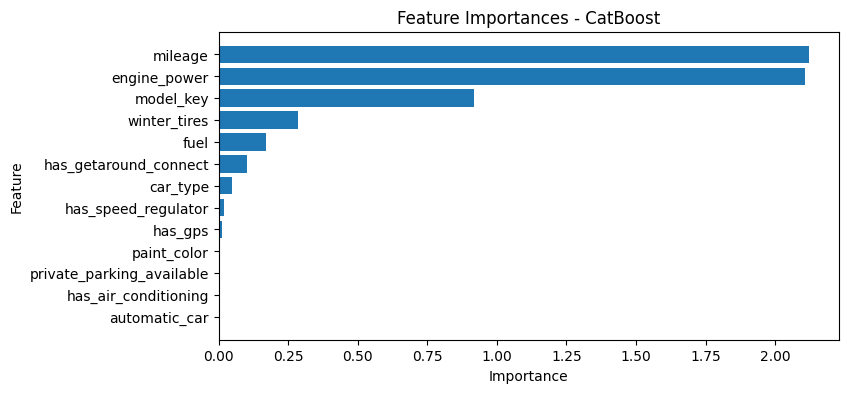

In [25]:
# Plot the sorted feature importance
plt.figure(figsize=(8, 4))
plt.barh(range(len(sorted_feature_importance)), sorted_feature_importance)
plt.ylabel('Feature')
plt.xlabel('Importance')
plt.title(f'Feature Importances - {BEST_name}')
plt.yticks(range(len(sorted_feature_importance)), sorted_feature_names)
plt.show()